# **Regulating Together Study**
## **ECG Quality Assessment Pipeline**

### 1. Import Libraries

In [1]:
from os import listdir, path
from time import sleep
from tqdm.notebook import tqdm
from ecgdetectors import Detectors
import pyedflib
import pandas as pd
import numpy as np
import datetime as dt
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
pd.options.mode.chained_assignment = None

### 2. Load and Preprocess Data

In [2]:
# directory = './new'
directory = '.'
ids = sorted([i for i in listdir(directory) if '.' not in i and i != 'new'])
print(f'IDs: {ids}')

IDs: ['101', '102', '103', '108', '110', '113']


In [3]:
edfs = []
txts = []
for i in tqdm(ids):
    edf = ''.join([f for f in listdir(f'{directory}/{i}') 
                   if f.endswith('EDF')])
    txt = ''.join([f for f in listdir(f'{directory}/{i}') 
                   if f.endswith('txt')])
    mw = ''.join([f for f in listdir(f'{directory}/{i}') 
                  if 'HRV Analysis' in f])

    # Read and write EDF data
    print(f'Pre-processing {i}...', end = ' ')
    f = pyedflib.EdfReader(f'{directory}/{i}/{edf}')
    date = f.getStartdatetime().date()
    date_str = date.strftime('%Y-%m-%d')
    signal_headers = f.getSignalHeaders()
    info = f.getHeader()
    for n in range(len(f.getSignalLabels())):
        if signal_headers[n]['label'] == 'ECG':
            signal = f.readSignal(n)
            fs = signal_headers[n]['sample_rate']
            start_time = dt.datetime.timestamp(info['startdate'])
            duration = len(signal) / fs
            end_time = start_time + duration
            ecg = pd.DataFrame({'mV': signal / 1000})
            ecg.insert(0, 'time', np.arange(start_time, end_time, (1 / fs)))
            ecg['time'] = ecg['time'].apply(
                lambda t: dt.datetime.fromtimestamp(t))
    ecg.to_csv(f'{directory}/{i}/{i}_ECG.csv', index = False)
            
    # Read timestamps data
    timestamps = pd.read_csv(f'{directory}/{i}/{txt}', sep = '\t').dropna()
    timestamps['TaskTime'] = f'{date_str} ' + timestamps['TaskTime']
    timestamps['TaskTime'] = timestamps['TaskTime'].apply(
        lambda t: dt.datetime.strptime(t, '%Y-%m-%d %H:%M:%S'))
    timestamps['PhysioStartTime'] = f.getStartdatetime()
    unmatch = [t for t in range(len(timestamps['TaskTime'])) if 
               timestamps.loc[t, 'TaskTime'].hour != 
               timestamps.loc[0, 'PhysioStartTime'].hour]
    timestamps.loc[unmatch, 'TaskTime'] = timestamps.TaskTime[unmatch].apply(
        lambda t: t + dt.timedelta(hours = 12))
    timestamps = timestamps.sort_values(by = ['TaskTime'])
    task_starts = timestamps[timestamps['TaskModifier'] == 'start'].reset_index(
        drop = True)
    task_ends = timestamps[timestamps['TaskModifier'] == 'stop'].reset_index(
        drop = True)
    new_timestamps = pd.DataFrame(columns = ['Task', 'Start', 'End'])
    for n in range(len(task_starts)):
        new_timestamps = pd.concat([new_timestamps, pd.DataFrame.from_records(
            [{'Task': task_starts.loc[n, 'Task'],
              'Start': task_starts.loc[n, 'TaskTime'],
              'End': task_ends.loc[n, 'TaskTime']}]
        )], ignore_index = True)
    new_timestamps.to_csv(f'{directory}/{i}/{i}_timestamps.csv', index = False)
    
    # Read MindWare data
    interval_stats = pd.read_excel(
        f'{directory}/{i}/{mw}', sheet_name = 'Interval Stats')
    trim_on = timestamps.loc[0, 'TaskTime']
    trim_off = timestamps.iloc[-1]['TaskTime']
    interval_stats.insert(
        3, 'Time', pd.to_datetime(
            (interval_stats['Interval Start Time'] + start_time).apply(
                lambda x: dt.datetime.fromtimestamp(x))))
    interval_stats = interval_stats[interval_stats['Time'].between(
        trim_on, trim_off)].reset_index(drop = True)
    
    # Add tasks
    interval_stats.insert(4, 'Task', 0)
    for n in range(len(new_timestamps)):
        df = interval_stats.loc[interval_stats['Time'].between(
            new_timestamps.loc[n, 'Start'], new_timestamps.loc[n, 'End']), :]
        df['Task'] = new_timestamps.loc[n, 'Task']
        df = df.loc[:, 'Task']
        interval_stats.update(df)
    interval_stats['Task'].replace(0, 'None', inplace = True)
    interval_stats.to_csv(
        f'{directory}/{i}/{i}_interval_stats.csv', index = False)
    print('done.')
    f.close()

  0%|          | 0/6 [00:00<?, ?it/s]

Pre-processing 101... done.
Pre-processing 102... done.
Pre-processing 103... done.
Pre-processing 108... done.
Pre-processing 110... done.
Pre-processing 113... done.


### 3. Assess Data Quality

#### 3.1. Calculate the detected and expected numbers of R peaks in each segment after trimming to the bounds of Baselines 1 and 3.

In [4]:
for i in tqdm(ids):
    print(f'Assessing data quality per segment for {i}...', end = ' ')
    interval_stats = pd.read_csv(f'{directory}/{i}/{i}_interval_stats.csv')
    peaks_by_seg = pd.DataFrame(columns = ['Segment', 'Detected', 'Expected'])
    n = 0
    seg = 1
    while n <= len(interval_stats):
        window = interval_stats.loc[n:n + 60]
        expected = 60000 / window['Mean IBI'].median()
        detected = window['# R Peaks'].sum()
        peaks_by_seg = pd.concat(
            [peaks_by_seg, pd.DataFrame.from_records([{
                'Segment': seg, 
                'Detected': detected, 
                'Expected': expected}])], 
            ignore_index = True)
        n += 60
        seg += 1
        
    # Calculate missingness
    missed = [n for n in range(len(peaks_by_seg)) 
              if peaks_by_seg.loc[n, 'Detected'] < peaks_by_seg.loc[n, 'Expected']]
    if len(missed) > 0:
        detected_missed = peaks_by_seg.loc[missed, 'Detected']
        expected_missed = peaks_by_seg.loc[missed, 'Expected']
        abs_diff = abs(detected_missed - expected_missed)
        peaks_by_seg.loc[missed, '% Missing'] = abs_diff / expected_missed
        peaks_by_seg.loc[~peaks_by_seg.index.isin(missed), '% Missing'] = 0.00
    else:
        peaks_by_seg['% Missing'] = 0.00
    
    # Write to CSV
    peaks_by_seg.to_csv(f'{directory}/{i}/{i}_peaks_by_segment.csv', index = False)
    sleep(1.0)
    print('done.')

  0%|          | 0/6 [00:00<?, ?it/s]

Assessing data quality per segment for 101... done.
Assessing data quality per segment for 102... done.
Assessing data quality per segment for 103... done.
Assessing data quality per segment for 108... done.
Assessing data quality per segment for 110... done.
Assessing data quality per segment for 113... done.


#### 3.2. Calculate the average detected and expected numbers of R peaks per segment during each task.

In [5]:
for i in tqdm(ids):
    print(f'Assessing data quality by segment per task for {i}...', end = ' ')
    peaks_by_task = pd.DataFrame(columns = ['Task', 'Segment', 'Detected', 'Expected'])
    interval_stats = pd.read_csv(f'{directory}/{i}/{i}_interval_stats.csv')
    for task in interval_stats['Task'].unique():
        df = interval_stats.loc[interval_stats['Task'] == task].reset_index(drop = True)
        seg = 1
        for n in range(0, len(df) - 60, 60):
            window = df.loc[n:n + 59]
            next_window = df.loc[n + 60:n + 119]
            if (len(window) == 60) and (len(next_window) == 60):
                expected = 60000 / window['Mean IBI'].median()
                detected = window['# R Peaks'].sum()
                peaks_by_task = pd.concat(
                    [peaks_by_task, pd.DataFrame.from_records([{
                        'Task': task,
                        'Segment': seg, 
                        'Detected': detected, 
                        'Expected': expected}])], 
                    ignore_index = True)
            else:
                window = df.loc[n:len(df)]
                expected = 60000 / window['Mean IBI'].median()
                detected = window['# R Peaks'].sum()
                peaks_by_task = pd.concat(
                    [peaks_by_task, pd.DataFrame.from_records([{
                        'Task': task,
                        'Segment': seg, 
                        'Detected': detected, 
                        'Expected': expected}])], 
                    ignore_index = True)
            seg += 1
    peaks_by_task.drop(peaks_by_task.index[peaks_by_task['Task'] == 'None'], 
                       inplace = True)
    peaks_by_task = peaks_by_task.reset_index(drop = True)
    
    # Calculate missingness
    missed = [n for n in range(len(peaks_by_task)) 
              if peaks_by_task.loc[n, 'Detected'] < peaks_by_task.loc[n, 'Expected']]
    if len(missed) > 0:
        detected_missed = peaks_by_task.loc[missed, 'Detected']
        expected_missed = peaks_by_task.loc[missed, 'Expected']
        abs_diff = abs(detected_missed - expected_missed)
        peaks_by_task.loc[missed, '% Missing'] = abs_diff / expected_missed
        peaks_by_task.loc[~peaks_by_task.index.isin(missed), '% Missing'] = 0.00
    else:
        peaks_by_task['% Missing'] = 0.00
        
    # Write to CSV
    peaks_by_task.to_csv(f'{directory}/{i}/{i}_peaks_by_task.csv', index = False)
    sleep(1.0)
    print('done.')

  0%|          | 0/6 [00:00<?, ?it/s]

Assessing data quality by segment per task for 101... done.
Assessing data quality by segment per task for 102... done.
Assessing data quality by segment per task for 103... done.
Assessing data quality by segment per task for 108... done.
Assessing data quality by segment per task for 110... done.
Assessing data quality by segment per task for 113... done.


### 5. Visualize Data

#### 5.1. Visualize the raw ECG data during a specific task for a participant.

In [6]:
participant = '101'
task = 'Breathing'

In [7]:
timestamps = pd.read_csv(f'{directory}/{participant}/{participant}_timestamps.csv')
task_start = timestamps.loc[timestamps['Task'] == task, 'Start'].item()
task_end = timestamps.loc[timestamps['Task'] == task, 'End'].item()
ecg = pd.read_csv(f'{directory}/{participant}/{participant}_ECG.csv')

In [8]:
# Compute R peaks or QRS complexes with different algorithms
detectors = Detectors(fs)
segment = ecg.loc[ecg['time'].between(task_start, task_end), 'mV'].reset_index(drop = True)
timeframe = ecg.loc[ecg['time'].between(task_start, task_end), 'time'].reset_index(drop = True)
pt_locs = detectors.pan_tompkins_detector(segment)  # Pan Tompkins
ham_locs = detectors.hamilton_detector(segment)  # Hamilton
chris_locs = detectors.christov_detector(segment)  # Christov
swt_locs = detectors.swt_detector(segment)  # stationary wavelet transform
engzee_locs = detectors.engzee_detector(segment)  # Engelse Zeelenberg
two_locs = detectors.two_average_detector(segment)  # two moving averages

In [9]:
peaks_by_task = pd.read_csv(f'{directory}/{participant}/{participant}_peaks_by_task.csv')
mw_peaks = peaks_by_task.loc[peaks_by_task.Task == task, 'Detected'].sum()
print(f'MindWare (Shannon Energy): {mw_peaks} peaks')
print(f'''-----------------------------------------
Pan Tomkins: {len(pt_locs)} peaks
Hamilton: {len(ham_locs)} peaks
Christov: {len(chris_locs)} peaks
Stationary Wavelet Transform: {len(swt_locs)} peaks
Engelse Zeelenberg: {len(engzee_locs)} peaks
Two Moving Average: {len(two_locs)} peaks
''')

MindWare (Shannon Energy): 310 peaks
-----------------------------------------
Pan Tomkins: 308 peaks
Hamilton: 308 peaks
Christov: 308 peaks
Stationary Wavelet Transform: 308 peaks
Engelse Zeelenberg: 272 peaks
Two Moving Average: 308 peaks



Plot the QRS complexes detected by the Pan–Tompkins algorithm [1].

In [10]:
peaks_y = [segment[i] for i in pt_locs]
peaks_x = [timeframe[i] for i in pt_locs]

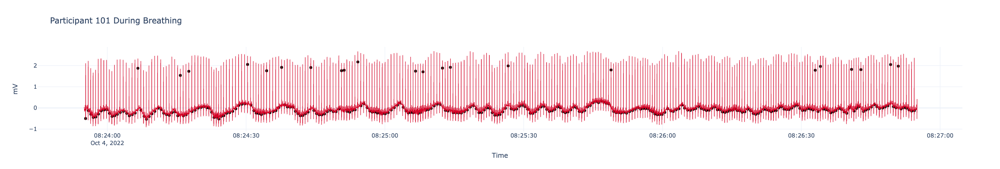

In [11]:
# Plot ECG signal
fig1 = px.line(
    ecg[ecg['time'].between(task_start, task_end)].reset_index(drop = True), 
    x = 'time', 
    y = 'mV', 
    height = 600)
fig1.update_traces(line = dict(width = 1, color = '#d40427'))

# Plot peaks
fig2 = px.scatter(x = peaks_x, y = peaks_y)
fig2.update_traces(marker = dict(size = 6, color = 'black'))

# Combine both plots
fig = go.Figure(data = fig2.data + fig1.data)
fig.update_layout(
    title = f'Participant {participant} During {task}',
    xaxis_title = 'Time',
    yaxis_title = 'mV', 
    template = 'plotly_white')
fig.show()

##### 5.2. Visualize the expected and detected number of R peaks in each segment.

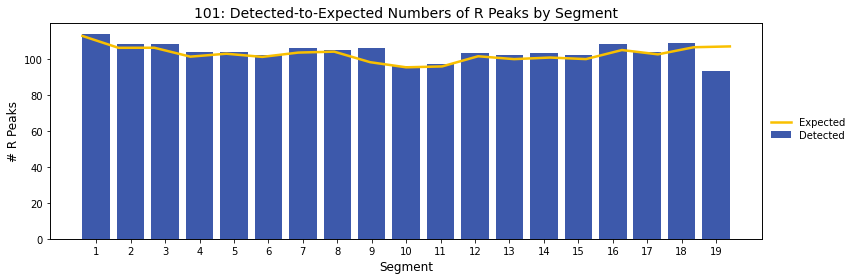

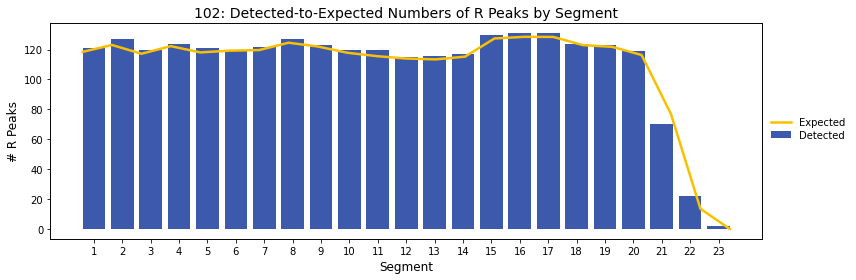

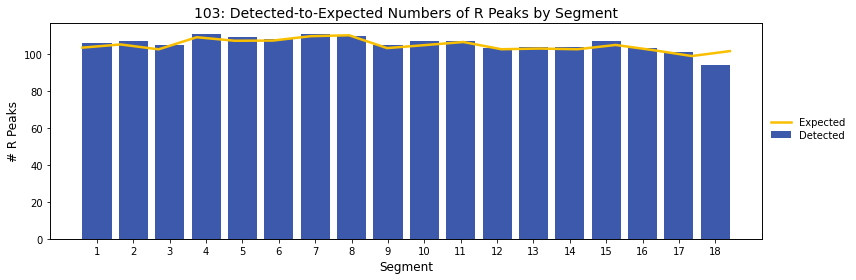

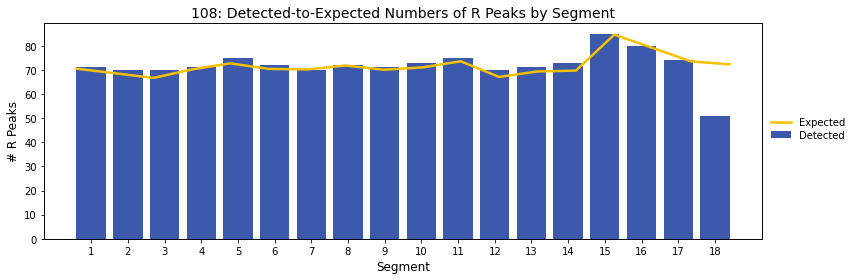

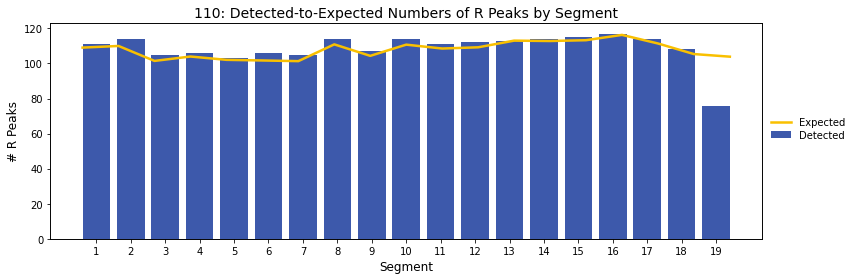

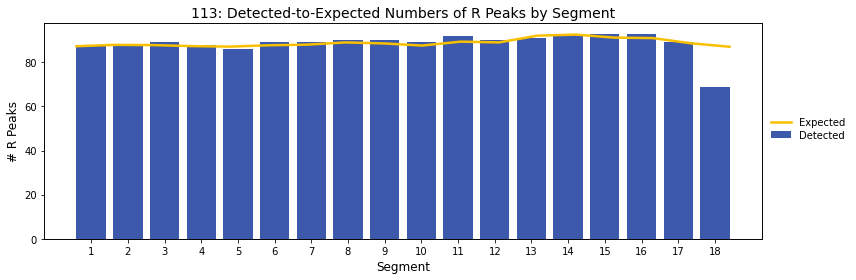

In [12]:
for i in ids:
    peaks = pd.read_csv(f'{directory}/{i}/{i}_peaks_by_segment.csv')
    fig, ax = plt.subplots(figsize = (12, 4), tight_layout = True)
    ax.bar(peaks['Segment'], peaks['Detected'], color = '#3d59ab', label = 'Detected')
    ax.set_xlabel('Segment', fontsize = 12)
    ax.set_ylabel('# R Peaks', fontsize = 12)
    ax.set_xticks(peaks['Segment'])
    ax.legend(loc = 'center left', bbox_to_anchor = (1, 0.48), frameon = False)
    ax2 = ax.twiny()
    ax2.plot(peaks['Segment'], peaks['Expected'], color = '#f9c000', label = 'Expected', linewidth = 2.5)
    ax2.legend(loc = 'center left', bbox_to_anchor = (1, 0.54), frameon = False)
    ax2.get_xaxis().set_visible(False)
    plt.title(f'{i}: Detected-to-Expected Numbers of R Peaks by Segment', fontsize = 14)
    plt.savefig(f'{directory}/{i}/{i}_ecgqa_segment.png', facecolor = 'white')

##### 5.3. Visualize the expected and detected number of R peaks during each task.

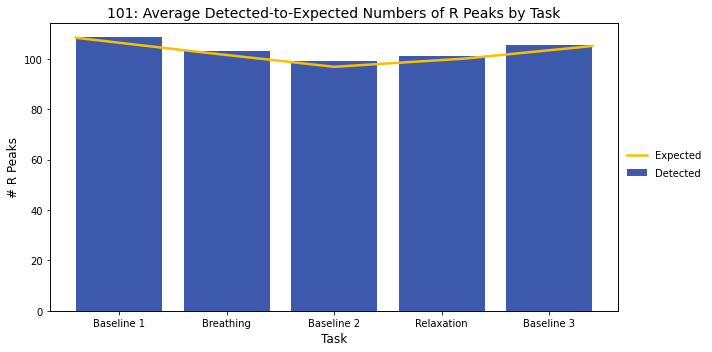

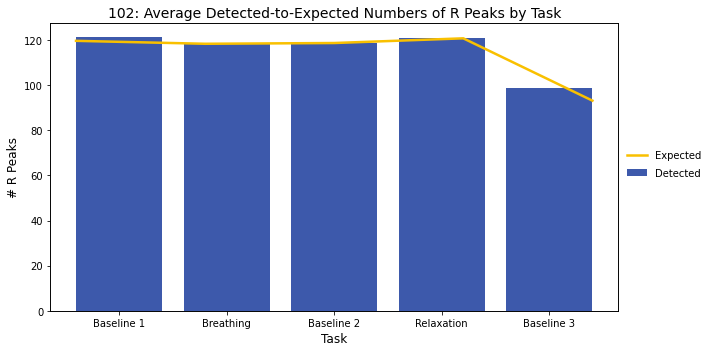

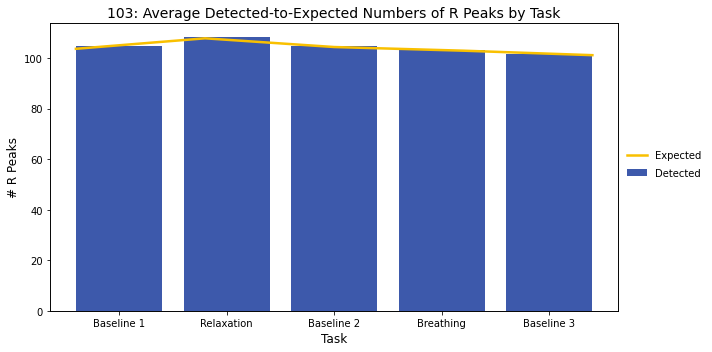

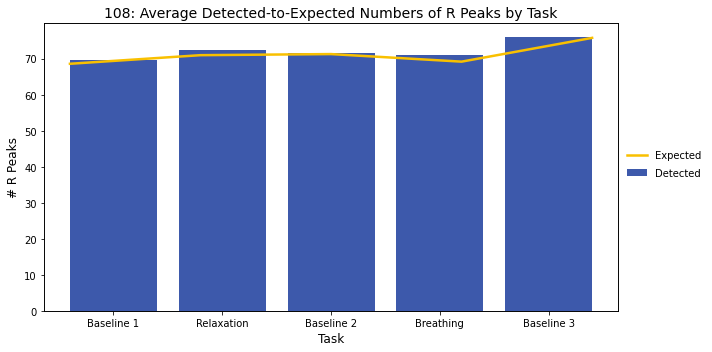

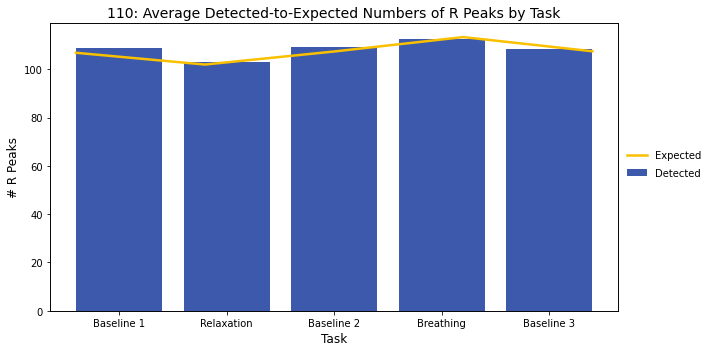

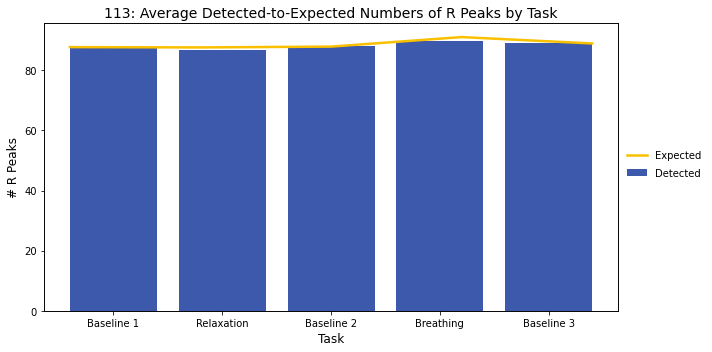

In [13]:
for i in ids:
    peaks = pd.read_csv(f'{directory}/{i}/{i}_peaks_by_task.csv')
    means_by_task = pd.DataFrame(columns = ['Task', 'Detected', 'Expected'])
    for t in peaks['Task'].unique():
        df = peaks[peaks['Task'] == t]
        means_by_task = pd.concat([means_by_task, pd.DataFrame.from_records([{
            'Task': t,
            'Detected': df.Detected.mean(),
            'Expected': df.Expected.mean()
        }])], ignore_index = True)
    fig, ax = plt.subplots(figsize = (10, 5), tight_layout = True)
    ax.bar(means_by_task['Task'], means_by_task['Detected'], color = '#3d59ab', label = 'Detected')
    ax.set_xlabel('Task', fontsize = 12)
    ax.set_ylabel('# R Peaks', fontsize = 12)
    ax.set_xticks(means_by_task['Task'])
    ax.legend(loc = 'center left', bbox_to_anchor = (1, 0.48), frameon = False)
    ax2 = ax.twiny()
    ax2.plot(means_by_task['Task'], means_by_task['Expected'], color = '#f9c000', label = 'Expected', linewidth = 2.5)
    ax2.legend(loc = 'center left', bbox_to_anchor = (1, 0.54), frameon = False)
    ax2.get_xaxis().set_visible(False)
    plt.title(f'{i}: Average Detected-to-Expected Numbers of R Peaks by Task', fontsize = 14)
    plt.savefig(f'{directory}/{i}/{i}_ecgqa_task.png', facecolor = 'white')

#### 6. Summarize Missingness by Task

In [14]:
ids = sorted([i for i in listdir('.') if i != 'new' and '.' not in i])

In [15]:
all_tasks = pd.DataFrame(columns = ['ID', 'Task', 'Average % Missing'])

for i in ids:
    peaks_by_task = pd.read_csv(f'{i}/{i}_peaks_by_task.csv')
    for task in peaks_by_task['Task'].unique().tolist():
        all_tasks = pd.concat([all_tasks, pd.DataFrame.from_records([{
            'ID': i,
            'Task': task,
            'Average % Missing': peaks_by_task.loc[(peaks_by_task['Task'] == task), '% Missing'].mean()
        }])], ignore_index = True)

In [16]:
all_tasks.groupby('Task').describe()['Average % Missing']

,count,mean,std,min,25%,50%,75%,max
Task,,,,,,,,
Baseline 1,6.0,0.001901,0.002018,0.0,0.000138,0.001757,0.002987,0.004898
Baseline 2,6.0,0.001279,0.002727,0.0,0.000000,0.000000,0.000657,0.006800
Baseline 3,6.0,0.003901,0.005664,0.0,0.000426,0.001717,0.004275,0.014846
Breathing,6.0,0.004951,0.005780,0.0,0.000960,0.002776,0.007313,0.014977
Relaxation,6.0,0.003559,0.005725,0.0,0.000000,0.000569,0.004763,0.014244


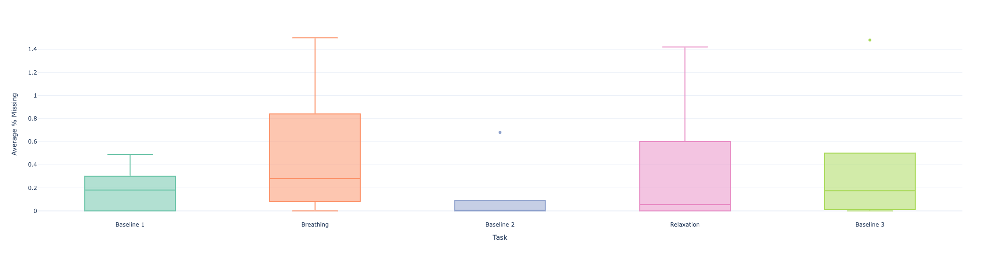

In [17]:
df = all_tasks.copy()
df['Average % Missing'] =  df['Average % Missing'].apply(lambda x: round(x * 100, 2)) 
boxplot = px.box(df, x = 'Task', y = 'Average % Missing', color = 'Task', color_discrete_sequence = px.colors.qualitative.Set2)
boxplot.update_layout(autosize = False, width = 900, height = 550,
                      template = 'plotly_white', showlegend = False)
boxplot.show()

### References

[1] Jiapu Pan and Willis J. Tompkins. 1985. A real-time QRS detection algorithm. *IEEE. Trans. Biomed. Eng* 32, 3 (Mar. 1985), 230-236. DOI: https://doi.org/10.1109/TBME.1985.325532